In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import numpy as np
from scipy.stats import chi2_contingency

In [3]:
df = pd.read_csv('dataset/gas_turbine_fault_detection.csv')

In [3]:
df.head()

,Temperature (°C),RPM,Torque (Nm),Vibrations (mm/s),Power Output (MW),Fuel Flow Rate (kg/s),Air Pressure (kPa),Exhaust Gas Temperature (°C),Oil Temperature (°C),Fault
0,924.835708,15650.870645,3464.645167,1.675087,96.347590,2.265294,146.245460,517.611726,90.530958,0
1,893.086785,15780.755598,3190.276340,2.042084,83.288302,2.755950,166.812134,500.196460,136.047350,0
2,932.384427,15016.002075,3401.769251,2.006414,120.358735,2.574244,133.494161,516.272719,124.910039,0
3,976.151493,14623.291065,3443.024901,2.239914,104.689781,2.497101,140.141635,475.731083,123.298231,1
4,888.292331,15229.986071,3448.764050,1.865677,95.080431,2.763689,109.795667,546.737163,119.382239,1


Ignorar columna Fault en la descripción del dataset, ya que esta es la variable target y además es binaria, por lo que los unicos datos destacables de esta variable son las proporciones que se verán a continuación

In [4]:
df.describe()

,Temperature (°C),RPM,Torque (Nm),Vibrations (mm/s),Power Output (MW),Fuel Flow Rate (kg/s),Air Pressure (kPa),Exhaust Gas Temperature (°C),Oil Temperature (°C),Fault
count,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000
mean,901.623932,15022.591497,3494.764285,1.978964,99.497230,2.505591,150.320568,498.865296,120.061923,0.306638
std,49.381498,490.048647,203.828153,0.494025,10.309697,0.316582,19.430192,28.793950,10.005188,0.461264
min,737.936633,13490.243922,2901.772806,0.411648,71.004861,1.349003,93.961769,382.327992,86.244209,0.000000
25%,868.117411,14688.039309,3355.445978,1.658465,92.387182,2.296762,137.688214,479.238499,113.652494,0.000000
50%,901.964879,15016.737353,3490.639925,1.989549,99.378143,2.500537,150.464896,498.865627,119.968056,0.000000
75%,932.692748,15346.057959,3627.482077,2.322288,106.454488,2.724751,163.130104,518.337798,126.570199,1.000000
max,1092.636575,16596.553784,4285.247541,3.556455,135.290552,3.513215,213.155426,587.423276,153.777682,1.000000


Medidas de Tendencia Central

In [5]:
for col in df:

    media = df[col].mean()
    mediana = df[col].median()
    moda = df[col].mode()[0]

    print(f"Medidas de Tendencia Central de {col}")
    print("Media:", media)
    print("Mediana:", mediana)
    print("Moda:", moda)
    print(f"\n")


Medidas de Tendencia Central de Temperature (°C)
Media: 901.6239322335476
Mediana: 901.9648792343021
Moda: 737.9366329965463


Medidas de Tendencia Central de RPM
Media: 15022.591496605442
Mediana: 15016.737353224902
Moda: 13490.243922089589


Medidas de Tendencia Central de Torque (Nm)
Media: 3494.764284880375
Mediana: 3490.6399247367985
Moda: 2901.7728058198554


Medidas de Tendencia Central de Vibrations (mm/s)
Media: 1.978963779662414
Mediana: 1.9895486658433126
Moda: 0.4116480934019997


Medidas de Tendencia Central de Power Output (MW)
Media: 99.49723041817633
Mediana: 99.37814266048608
Moda: 71.00486120131518


Medidas de Tendencia Central de Fuel Flow Rate (kg/s)
Media: 2.505591215591272
Mediana: 2.5005366870974073
Moda: 1.349003335462189


Medidas de Tendencia Central de Air Pressure (kPa)
Media: 150.32056771120966
Mediana: 150.4648956065924
Moda: 93.96176861024216


Medidas de Tendencia Central de Exhaust Gas Temperature (°C)
Media: 498.8652963950645
Mediana: 498.865626871581

Medidas de Dispersión

In [6]:
for col in df:

    varianza = df[col].var()
    desviacion = df[col].std()
    min = df[col].min()
    max = df[col].max()
    rango = max - min
    coef_variacion = desviacion / media

    print(f"Medidas de Dispersión de {col}")
    print("Varianza:", varianza)
    print("Desviación estándar:", desviacion)
    print("Min:", min)
    print("Max:", max)
    print("Rango:", rango)
    print("Coeficiente de variación:", coef_variacion)
    print(f"\n")

Medidas de Dispersión de Temperature (°C)
Varianza: 2438.532320558112
Desviación estándar: 49.38149775531431
Min: 737.9366329965463
Max: 1092.6365745327362
Rango: 354.69994153618984
Coeficiente de variación: 161.04177856203677


Medidas de Dispersión de RPM
Varianza: 240147.67628875957
Desviación estándar: 490.04864685943124
Min: 13490.243922089589
Max: 16596.55378392243
Rango: 3106.309861832842
Coeficiente de variación: 1598.1351165815804


Medidas de Dispersión de Torque (Nm)
Varianza: 41545.9158869913
Desviación estándar: 203.82815283221134
Min: 2901.7728058198554
Max: 4285.247541287265
Rango: 1383.47473546741
Coeficiente de variación: 664.7195760598704


Medidas de Dispersión de Vibrations (mm/s)
Varianza: 0.24406075035767708
Desviación estándar: 0.4940250503341678
Min: 0.4116480934019997
Max: 3.5564551005219203
Rango: 3.144807007119921
Coeficiente de variación: 1.6111028700309566


Medidas de Dispersión de Power Output (MW)
Varianza: 106.28986078936515
Desviación estándar: 10.3096

Medidas de Posición

In [7]:
for col in df:

    cuartiles = df[col].quantile([0.25, 0.5, 0.75])

    print(f"Medidas de Posición de {col}")
    print("Cuartiles:\n", cuartiles)
    print(f"\n")

Medidas de Posición de Temperature (°C)
Cuartiles:
 0.25    868.117411
0.50    901.964879
0.75    932.692748
Name: Temperature (°C), dtype: float64


Medidas de Posición de RPM
Cuartiles:
 0.25    14688.039309
0.50    15016.737353
0.75    15346.057959
Name: RPM, dtype: float64


Medidas de Posición de Torque (Nm)
Cuartiles:
 0.25    3355.445978
0.50    3490.639925
0.75    3627.482077
Name: Torque (Nm), dtype: float64


Medidas de Posición de Vibrations (mm/s)
Cuartiles:
 0.25    1.658465
0.50    1.989549
0.75    2.322288
Name: Vibrations (mm/s), dtype: float64


Medidas de Posición de Power Output (MW)
Cuartiles:
 0.25     92.387182
0.50     99.378143
0.75    106.454488
Name: Power Output (MW), dtype: float64


Medidas de Posición de Fuel Flow Rate (kg/s)
Cuartiles:
 0.25    2.296762
0.50    2.500537
0.75    2.724751
Name: Fuel Flow Rate (kg/s), dtype: float64


Medidas de Posición de Air Pressure (kPa)
Cuartiles:
 0.25    137.688214
0.50    150.464896
0.75    163.130104
Name: Air Pres

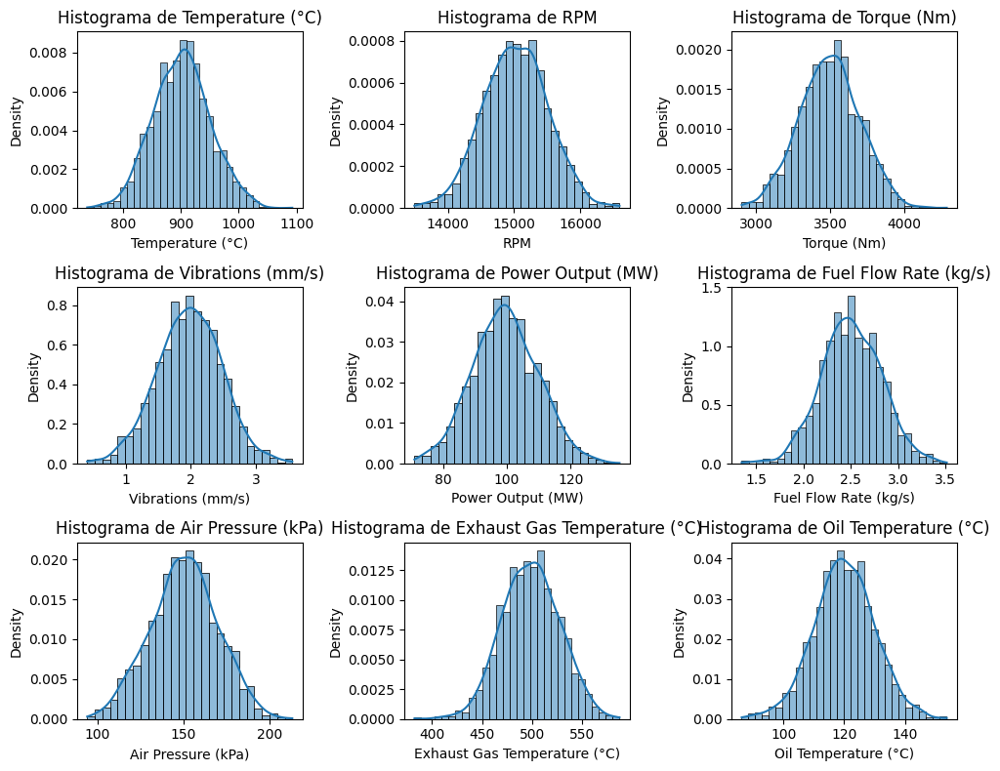

In [8]:
fig, axs = plt.subplots(3, 3, figsize=(10, 8))
i = 0
j = 0

for col in df:
    if i == 3:
        break
    
    sns.histplot(data=df, x=col, kde=True, ax=axs[i, j], stat='density')
    
    axs[i, j].set_title(f'Histograma de {col}')
    axs[i, j].set_xlabel(f'{col}')
    
    j += 1
    if j == 3:
        i += 1
        j = 0

plt.tight_layout()
plt.show()

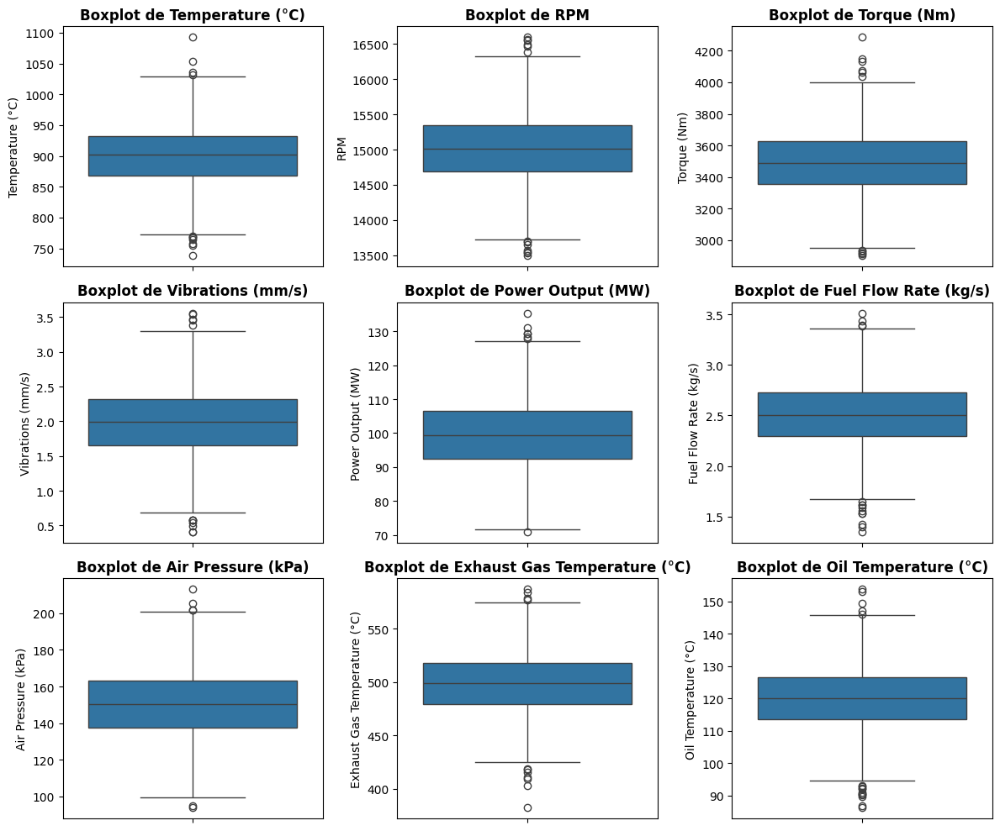

In [9]:
fig, axs = plt.subplots(3, 3, figsize=(12, 10))
i = 0
j = 0

for col in df:
    if i == 3:
        break
    
    sns.boxplot(data=df, y=col, ax=axs[i, j])
    
    axs[i, j].set_title(f'Boxplot de {col}', fontweight='bold')
    axs[i, j].set_ylabel(f'{col}')
    
    j += 1
    if j == 3:
        i += 1
        j = 0

plt.tight_layout()
plt.show()

Las variables siguen aparentemente una distribución normal, sin embargo hay presencia de outlayers. Hay que comprobar con el test de Shapiro-Wilk

In [10]:
alpha = 0.05

for col in df:
    if col == 'Fault':
        break
    stat, p = stats.shapiro(df[col])
    print(f'------{col}------')
    print(f'Estadistico W: {stat:.4f}')
    print(f'p-value: {p:.4f}')
    if p > alpha:
        print('No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal')
    else:
        print('Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal')


------Temperature (°C)------
Estadistico W: 0.9991
p-value: 0.7402
No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal
------RPM------
Estadistico W: 0.9992
p-value: 0.8260
No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal
------Torque (Nm)------
Estadistico W: 0.9991
p-value: 0.7063
No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal
------Vibrations (mm/s)------
Estadistico W: 0.9990
p-value: 0.6231
No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal
------Power Output (MW)------
Estadistico W: 0.9987
p-value: 0.4328
No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal
------Fuel Flow Rate (kg/s)------
Estadistico W: 0.9984
p-value: 0.2010
No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal
------Air Pressure (kPa)------
Estadistico W: 0.9983
p-value: 0.1889
No se rechaza la hipotesis nula y por tanto los datos 

Parece que todas las variables siguen una distribución normal, verifiquemos como se comporta la variable objetivo

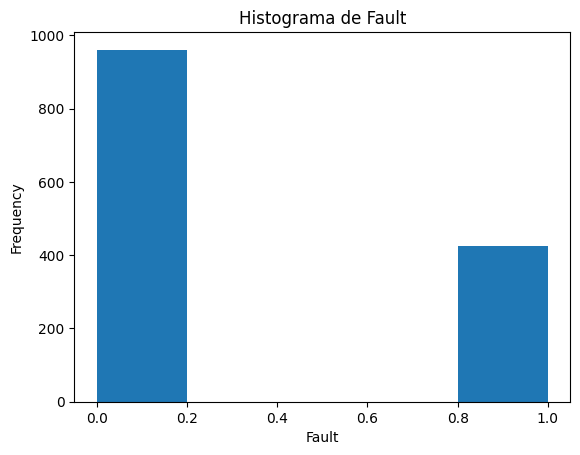

In [11]:
df['Fault'].plot.hist(bins=5)
plt.title('Histograma de Fault')
plt.xlabel('Fault')
plt.show()

Existen menos observaciones de turbinas que fallaron en comparación con las que no fallaron en el dataset, por lo que la variable está desvalanceada

In [12]:
print("Proporciones de Fault:")
print(df['Fault'].value_counts(normalize=True))

Proporciones de Fault:
Fault
0    0.693362
1    0.306638
Name: proportion, dtype: float64


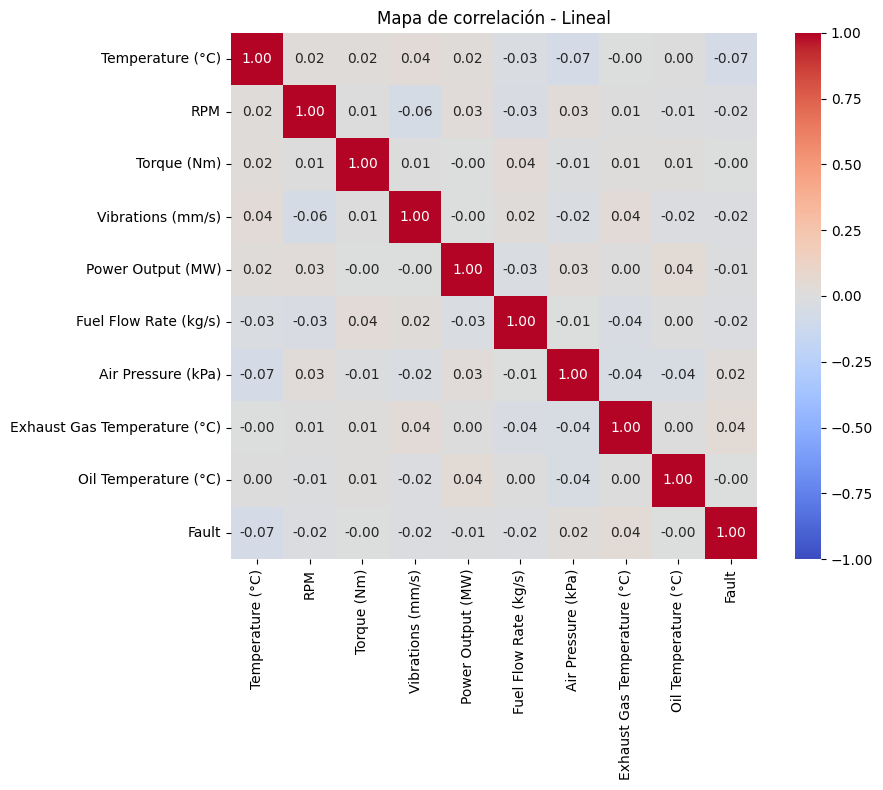

In [22]:
plt.figure(figsize=(10,8))
sns.heatmap(df.corr(), 
            cmap='coolwarm', 
            center=0,
            vmin=-1,    
            vmax=1,     
            annot=True,  
            fmt=".2f",   
            square=True) 
plt.title('Mapa de correlación - Lineal')
plt.tight_layout()
plt.show()

Parece que ninguna variable está relacionada linealmente, verifiquemos si pueda existir algún otro tipo de relación entre ellas

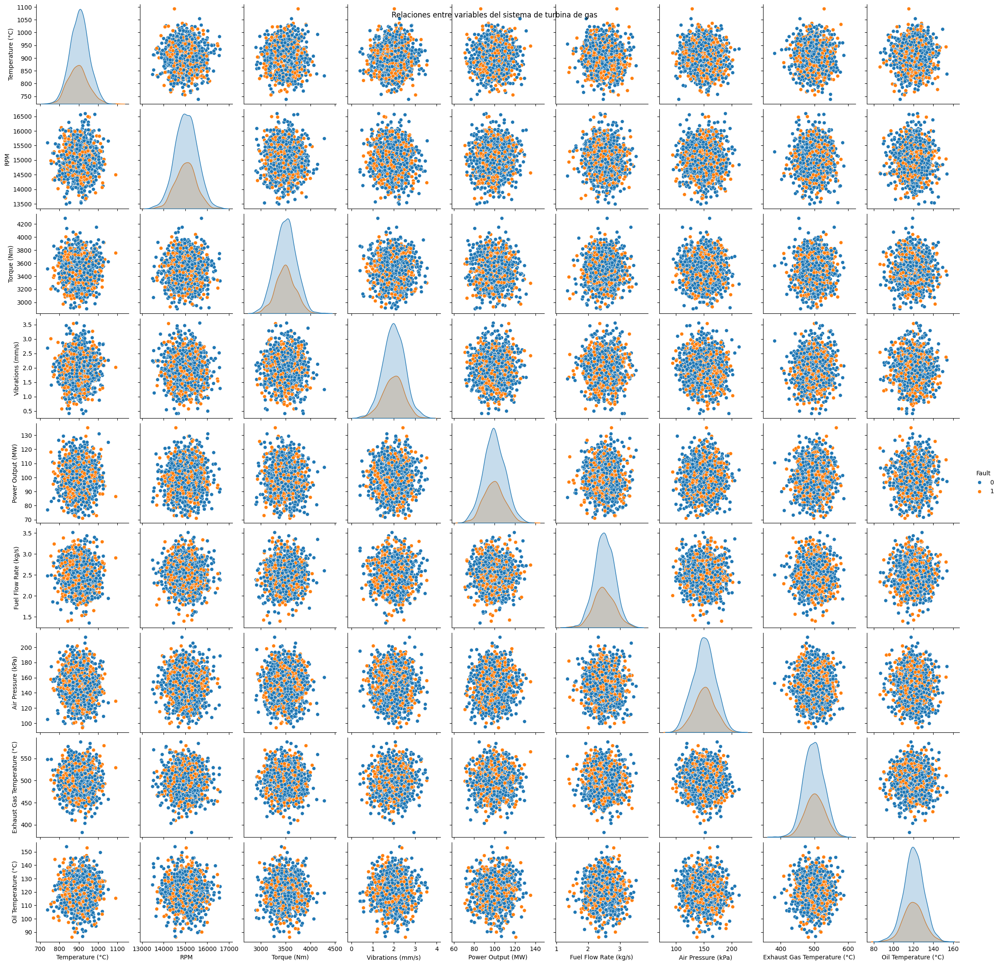

In [14]:
sns.pairplot(df, diag_kind="kde", hue="Fault")
plt.suptitle("Relaciones entre variables del sistema de turbina de gas")
plt.show()

Parece que ninguna variable está relacionada, visualicemos su relación con la variable objetivo

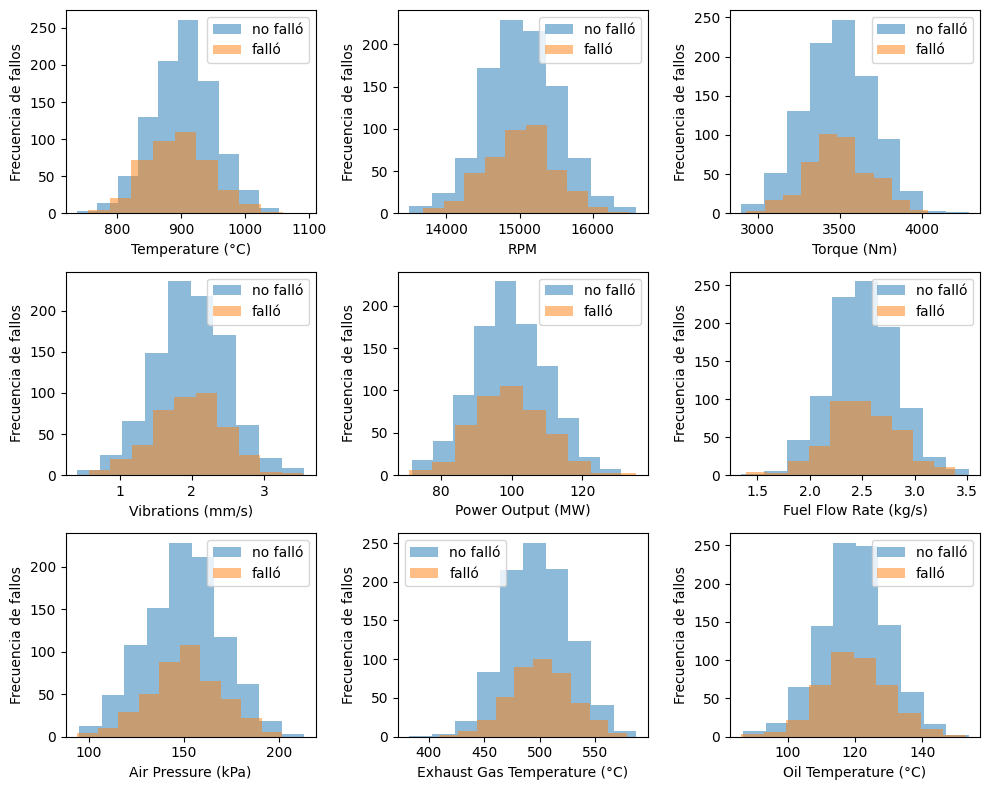

In [15]:
fig, axs = plt.subplots(3,3, figsize=(10,8))
i = 0
j = 0
for col in df:
    if i==3:
        break
    
    cat0 = df[df['Fault'] == 0][col]
    cat1 = df[df['Fault'] == 1][col]

    axs[i,j].hist(cat0, alpha=0.5, label='no falló', bins=10)
    axs[i,j].hist(cat1, alpha=0.5, label='falló', bins=10)
    axs[i,j].legend()
    axs[i,j].set_xlabel(f'{col}')
    axs[i,j].set_ylabel('Frecuencia de fallos')
    # axs[i,j].set_title('Distribución comparativa')
    j+=1
    if j==3:
        i+=1
        j=0

plt.tight_layout()
plt.show()

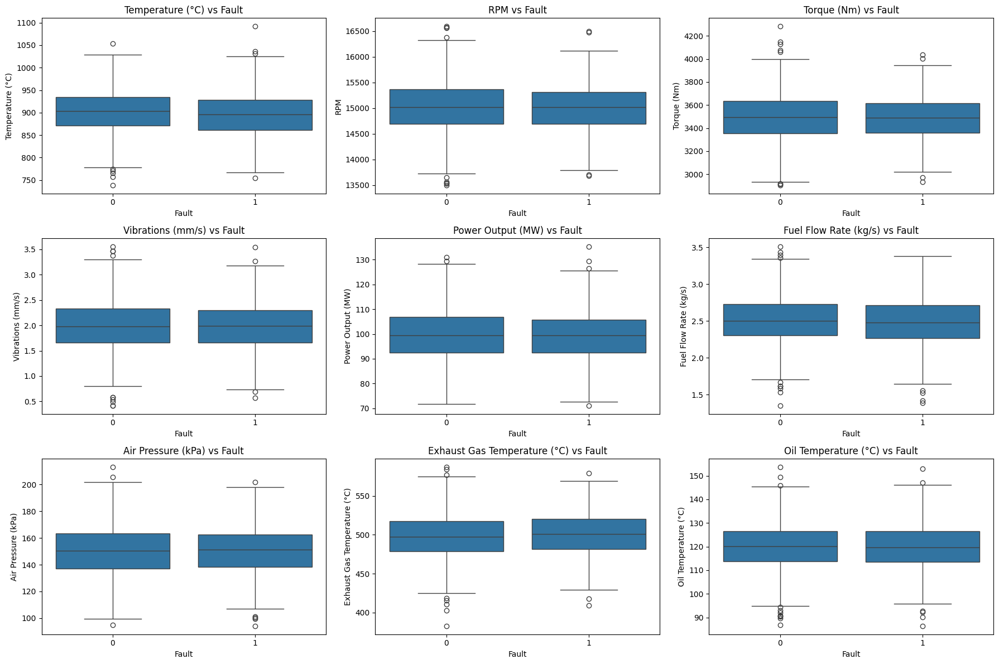

In [16]:
fig, axes = plt.subplots(3, 3, figsize=(18, 12))

i = 0
j = 0
for col in df:
    if i==3:
        break
    sns.boxplot(data=df, x='Fault', y=col, ax=axes[i,j])
    # sns.violinplot(data=df, x='Fault', y=col, ax=axes[i,j])
    axes[i,j].set_title(f'{col} vs Fault')
    j+=1
    if j==3:
        i+=1
        j=0
    
plt.tight_layout()
plt.show()

Al ser un dataset sintético, todas las variables están normalizadas por lo que no se puede sacar ningún tipo de relación entre ellas. La conclusión final más evidente es que la variable target está desvalanceada y por lo tanto es un detalle a tener en cuenta en el trabajo.

Probando a categorizar las variables

In [17]:
df_cat = df.copy()

for col in df:

    if col == "Fault":
        break
    
    min = df[col].min()
    max = df[col].max()
    mu = df[col].mean()
    sigma = df[col].std()

    df_cat[col] = pd.cut(
        df_cat[col],
        bins=[min, mu - sigma, mu + sigma, max],
        labels=["Bajo", "Medio", "Alto"]
    )

In [18]:
df_cat.head()

,Temperature (°C),RPM,Torque (Nm),Vibrations (mm/s),Power Output (MW),Fuel Flow Rate (kg/s),Air Pressure (kPa),Exhaust Gas Temperature (°C),Oil Temperature (°C),Fault
0,Medio,Alto,Medio,Medio,Medio,Medio,Medio,Medio,Bajo,0
1,Medio,Alto,Bajo,Medio,Bajo,Medio,Medio,Medio,Alto,0
2,Medio,Medio,Medio,Medio,Alto,Medio,Medio,Medio,Medio,0
3,Alto,Medio,Medio,Medio,Medio,Medio,Medio,Medio,Medio,1
4,Medio,Medio,Medio,Medio,Medio,Medio,Bajo,Alto,Medio,1


Tablas de Contingencia y Test de Chi cuadrado de independencia

In [19]:
cols = df_cat.columns

for i in range(len(cols)):
    for j in range(i+1, len(cols)):  # evita duplicados invertidos

        col1, col2 = cols[i], cols[j]
        tabla = pd.crosstab(df_cat[col1], df_cat[col2], margins=True)

        chi2, p, gl, esp = chi2_contingency(tabla)
        
        print(f"\n📌 Tabla de contingencia entre: {col1} vs {col2}\n")
        print(tabla)
        print(f"Chi²={chi2:.4f} | p-valor={p:.4f} | GL={gl}")
        if p > 0.05:
            print("No se rechaza la hipótesis nula, por lo tanto las variables son independientes")
        else:
            print("Se rechaza la hipótesis nula, por lo tanto las variables son dependientes")
        print("-" * 60)


📌 Tabla de contingencia entre: Temperature (°C) vs RPM

RPM               Bajo  Medio  Alto   All
Temperature (°C)                         
Bajo                40    149    33   222
Medio              147    645   152   944
Alto                31    157    30   218
All                218    951   215  1384
Chi²=2.2180 | p-valor=0.9875 | GL=9
No se rechaza la hipótesis nula, por lo tanto las variables son independientes
------------------------------------------------------------

📌 Tabla de contingencia entre: Temperature (°C) vs Torque (Nm)

Torque (Nm)       Bajo  Medio  Alto   All
Temperature (°C)                         
Bajo                26    156    41   223
Medio              161    637   145   943
Alto                29    147    42   218
All                216    940   228  1384
Chi²=6.6458 | p-valor=0.6739 | GL=9
No se rechaza la hipótesis nula, por lo tanto las variables son independientes
------------------------------------------------------------

📌 Tabla de contingenc

Las variables no aportan informacion ni de forma no lineal, por lo que la variable traget puede ser no predecible

In [23]:
from sklearn.feature_selection import mutual_info_regression

X = df.drop(columns=["Fault"])
y = df["Fault"]

mi = mutual_info_regression(X, y)
pd.Series(mi, index=X.columns).sort_values(ascending=False)


Vibrations (mm/s)               0.009009
RPM                             0.004446
Temperature (°C)                0.000000
Torque (Nm)                     0.000000
Power Output (MW)               0.000000
Fuel Flow Rate (kg/s)           0.000000
Air Pressure (kPa)              0.000000
Exhaust Gas Temperature (°C)    0.000000
Oil Temperature (°C)            0.000000
dtype: float64

In [3]:
df = pd.read_csv('dataset/gas_turbine_fault_detection_simulated2.csv')

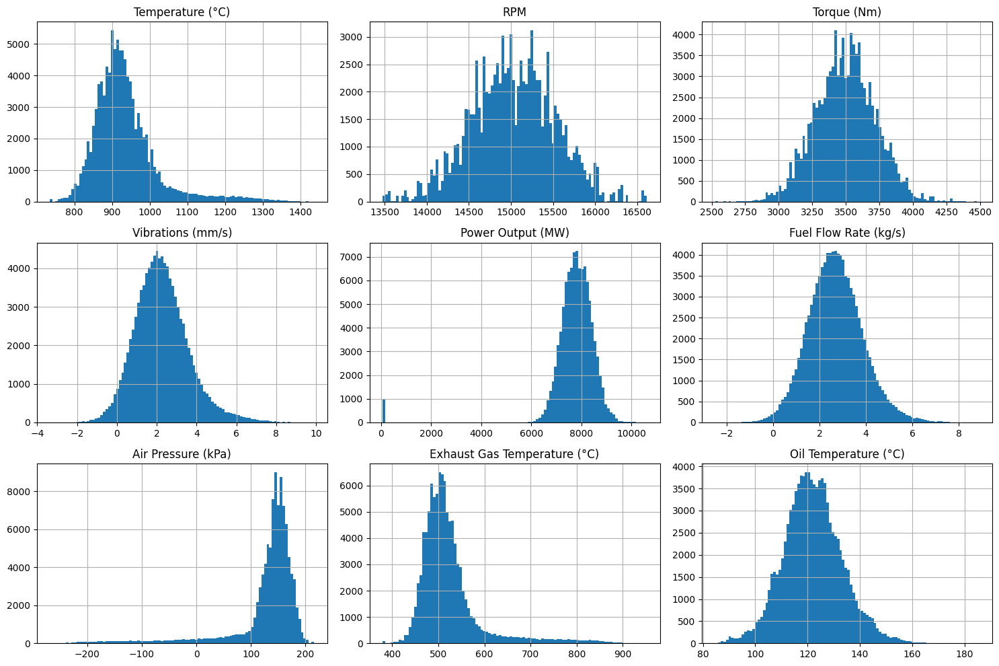

In [3]:
# Especificar exactamente qué columnas incluir
include_cols = [col for col in df.columns 
                if col not in ['Fault', 'Fault Mode', 'Turbine ID', 'TTC']]

df.hist(column=include_cols, bins=100, figsize=(15, 10), layout=(-1, 3))
plt.tight_layout()
plt.show()

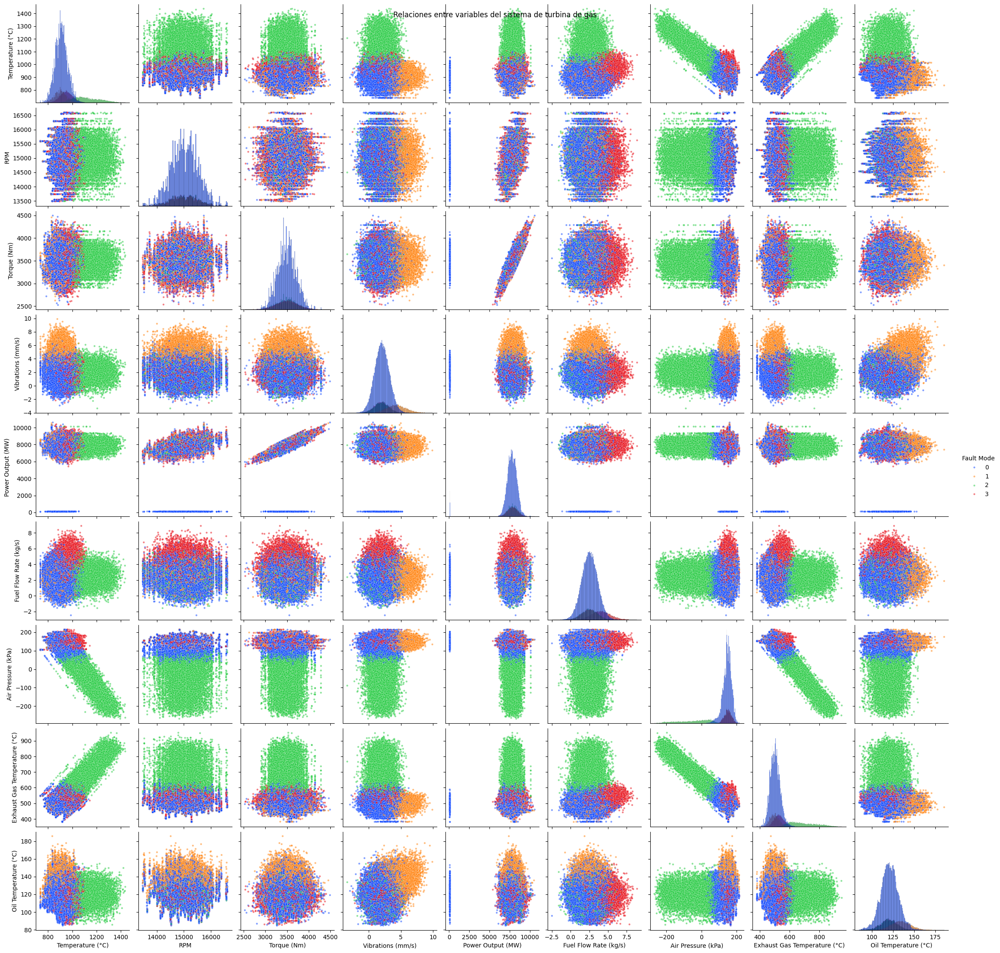

In [4]:
# Especificar exactamente qué columnas incluir
include_cols = [col for col in df.columns 
                if col not in ['Fault', 'Turbine ID', 'TTC']]

sns.pairplot(df[include_cols], diag_kind="hist", hue="Fault Mode", plot_kws={'alpha': 0.5, 's': 10}, palette='bright')
plt.suptitle("Relaciones entre variables del sistema de turbina de gas")
plt.show()

In [4]:
# Identificar los índices de las 1000 observaciones más pequeñas en la variable
smallest_indices = df['Power Output (MW)'].nsmallest(1000).index

# Eliminar esas filas del DataFrame
df_sin_pequenos = df.drop(smallest_indices)

print(f"Tamaño original: {len(df)}")
print(f"Tamaño después de eliminar: {len(df_sin_pequenos)}")

Tamaño original: 101000
Tamaño después de eliminar: 100000


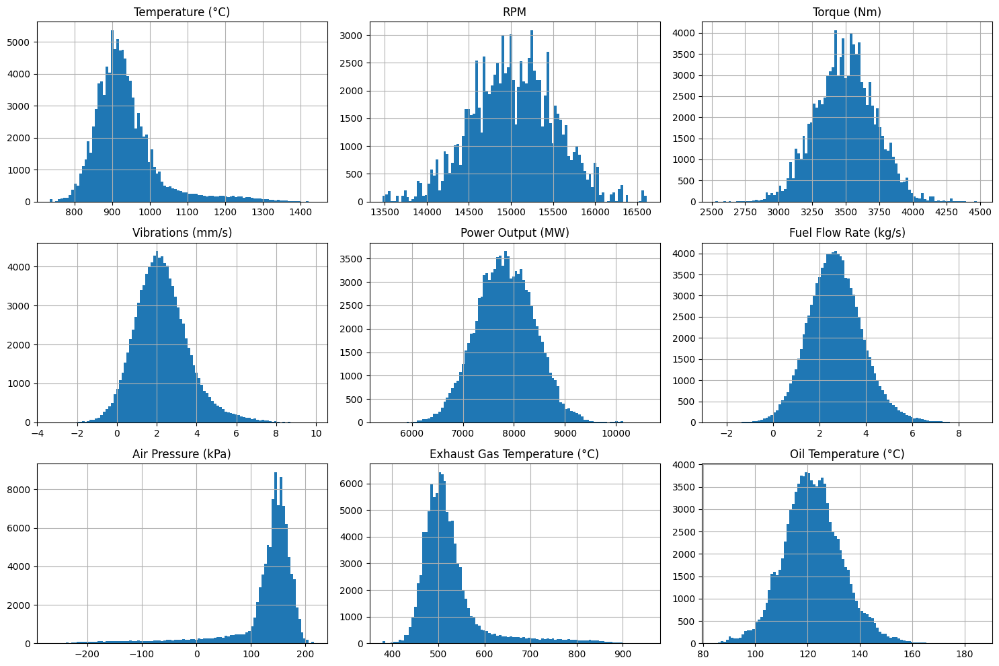

In [6]:
# Especificar exactamente qué columnas incluir
include_cols = [col for col in df_sin_pequenos.columns 
                if col not in ['Fault', 'Fault Mode', 'Turbine ID', 'TTC']]

df_sin_pequenos.hist(column=include_cols, bins=100, figsize=(15, 10), layout=(-1, 3))
plt.tight_layout()
plt.show()

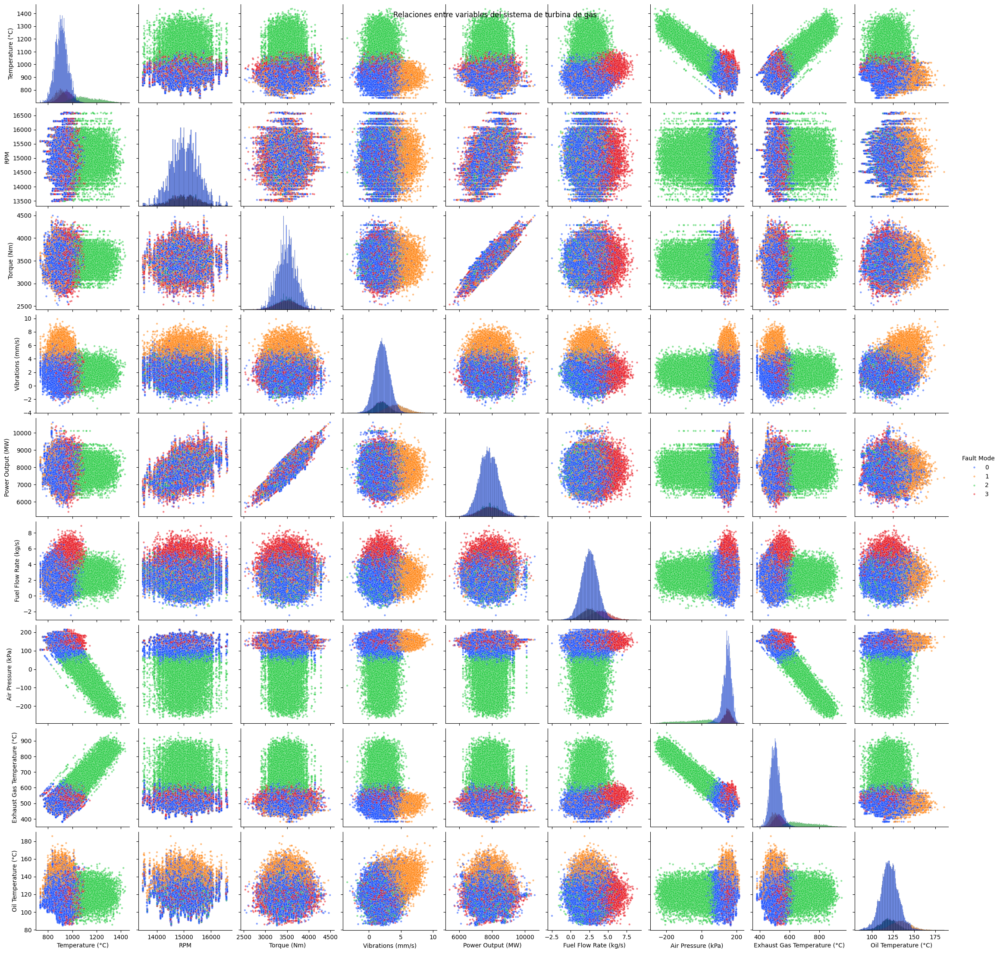

In [7]:
# Especificar exactamente qué columnas incluir
include_cols = [col for col in df_sin_pequenos.columns 
                if col not in ['Fault', 'Turbine ID', 'TTC']]

sns.pairplot(df_sin_pequenos[include_cols], diag_kind="hist", hue="Fault Mode", plot_kws={'alpha': 0.5, 's': 10}, palette='bright')
plt.suptitle("Relaciones entre variables del sistema de turbina de gas")
plt.show()

In [8]:
print("Proporciones de Fault:")
print(df_sin_pequenos['Fault'].value_counts(normalize=True))

Proporciones de Fault:
Fault
0.0    0.69
1.0    0.31
Name: proportion, dtype: float64


In [9]:
print("Proporciones de Fault Mode:")
print(df_sin_pequenos['Fault Mode'].value_counts(normalize=True))

Proporciones de Fault Mode:
Fault Mode
0    0.69000
3    0.10416
1    0.10292
2    0.10292
Name: proportion, dtype: float64


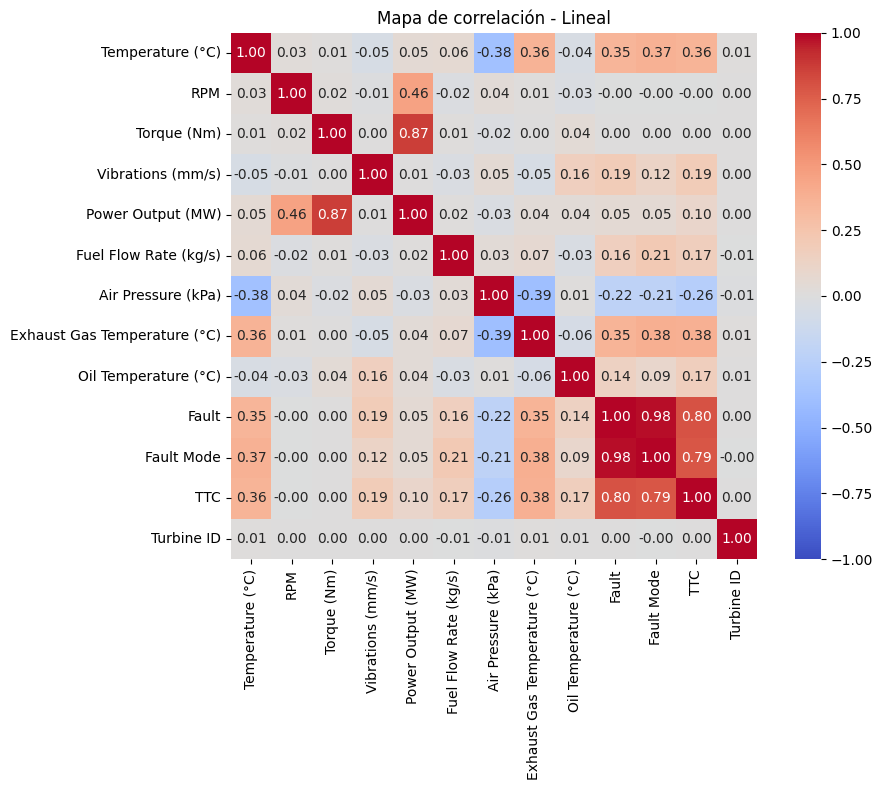

In [10]:
plt.figure(figsize=(10,8))
sns.heatmap(df_sin_pequenos.corr(method='spearman'), 
            cmap='coolwarm', 
            center=0,
            vmin=-1,    
            vmax=1,     
            annot=True,  
            fmt=".2f",   
            square=True) 
plt.title('Mapa de correlación - Lineal')
plt.tight_layout()
plt.show()

In [12]:
df_sin_pequenos.describe()

,Temperature (°C),RPM,Torque (Nm),Vibrations (mm/s),Power Output (MW),Fuel Flow Rate (kg/s),Air Pressure (kPa),Exhaust Gas Temperature (°C),Oil Temperature (°C),Fault,Fault Mode,TTC,Turbine ID
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,935.073065,15027.685651,3495.432052,2.268214,7831.390617,2.699936,126.808886,524.688846,122.031280,0.310000,0.621240,50.500000,500.500000
std,86.238025,501.459344,221.542896,1.365290,569.892536,1.169739,67.831291,69.728009,11.243859,0.462496,1.032527,28.866214,288.676434
min,735.544252,13475.030465,2526.988233,-3.354802,5421.223914,-2.481370,-268.233109,379.401272,84.697353,0.000000,0.000000,1.000000,1.000000
25%,883.017737,14686.935278,3346.472142,1.355506,7435.661772,1.909659,124.468647,485.055381,114.706243,0.000000,0.000000,25.750000,250.750000
50%,920.100819,15016.075097,3494.236233,2.166915,7826.491407,2.656677,145.134705,508.993756,121.618623,0.000000,0.000000,50.500000,500.500000
75%,965.097281,15363.798122,3642.473972,3.041008,8225.781863,3.430439,160.319795,538.148037,128.954263,1.000000,1.000000,75.250000,750.250000
max,1436.932748,16612.953571,4494.000362,9.900629,10607.309428,8.876661,215.888080,951.799529,185.695302,1.000000,3.000000,100.000000,1000.000000


In [16]:
alpha = 0.05

for col in df_sin_pequenos:
    if col == 'Fault' or col == 'Fault Mode' or col == 'TTC' or col == 'Turbine ID':
        break
    sample_data = np.random.choice(df_sin_pequenos[col], 5000, replace=False)
    stat, p = stats.shapiro(sample_data)
    print(f'------{col}------')
    print(f'Estadistico W: {stat:.4f}')
    print(f'p-value: {p:.4f}')
    if p > alpha:
        print('No se rechaza la hipotesis nula y por tanto los datos siguen distribucion normal')
    else:
        print('Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal')

------Temperature (°C)------
Estadistico W: 0.8722
p-value: 0.0000
Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal
------RPM------
Estadistico W: 0.9988
p-value: 0.0007
Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal
------Torque (Nm)------
Estadistico W: 0.9987
p-value: 0.0005
Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal
------Vibrations (mm/s)------
Estadistico W: 0.9807
p-value: 0.0000
Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal
------Power Output (MW)------
Estadistico W: 0.9988
p-value: 0.0011
Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal
------Fuel Flow Rate (kg/s)------
Estadistico W: 0.9962
p-value: 0.0000
Se rechaza la hipotesis nula y por tanto los datos no siguen una distribucion normal
------Air Pressure (kPa)------
Estadistico W: 0.6594
p-value: 0.0000
Se rechaza la hipotesis nula y

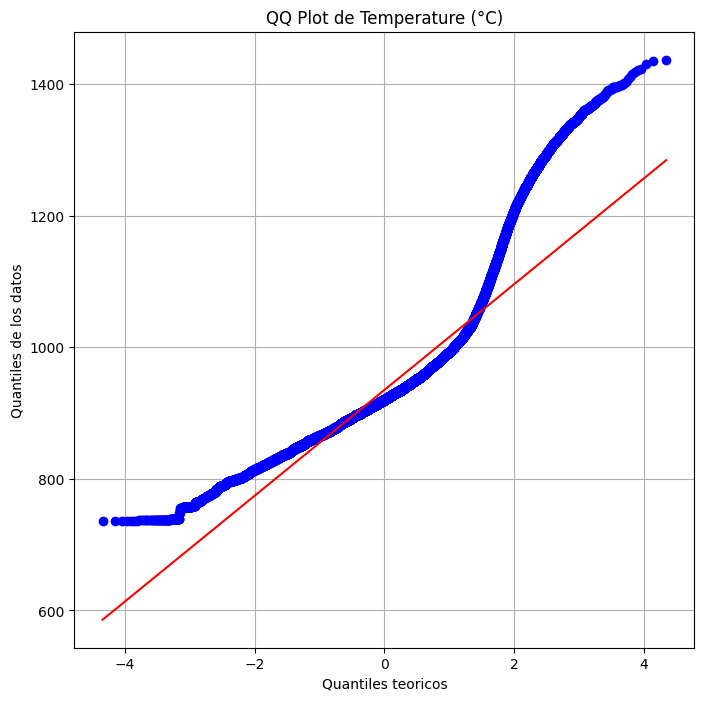

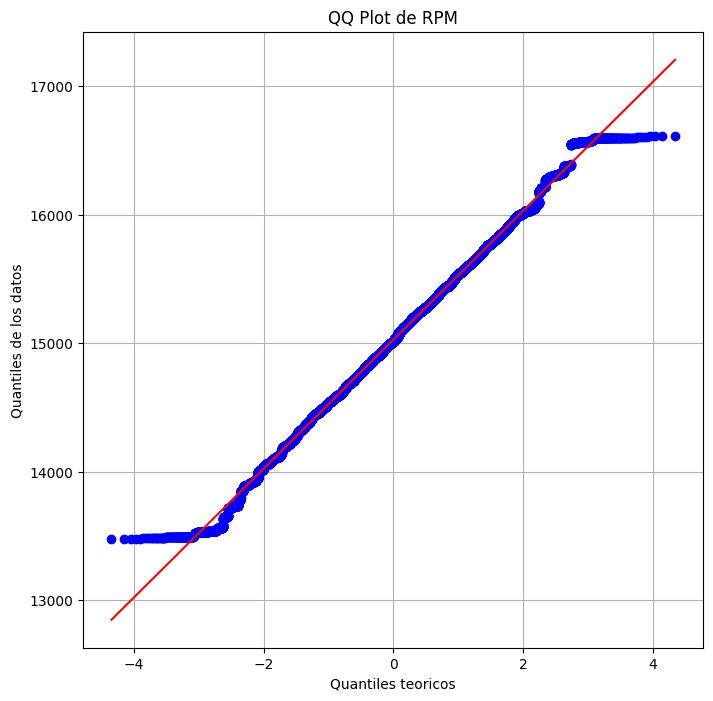

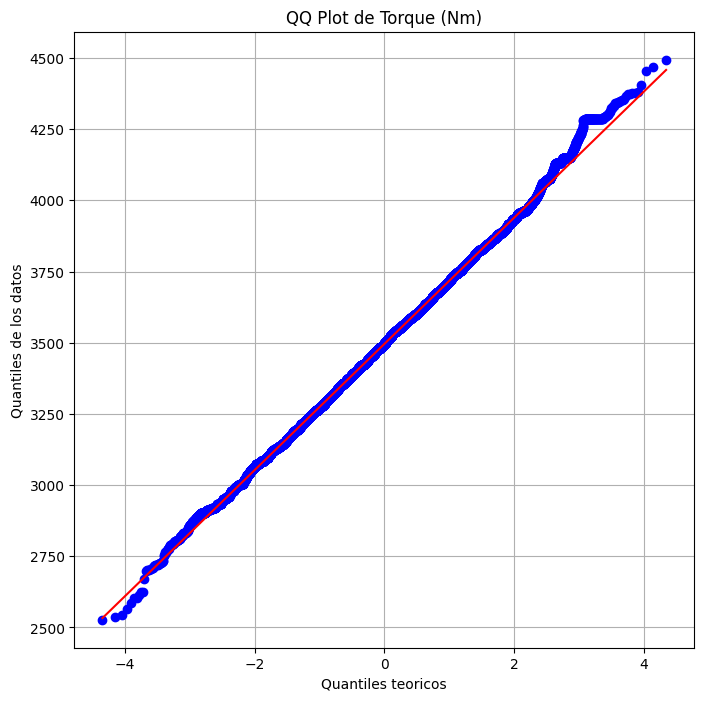

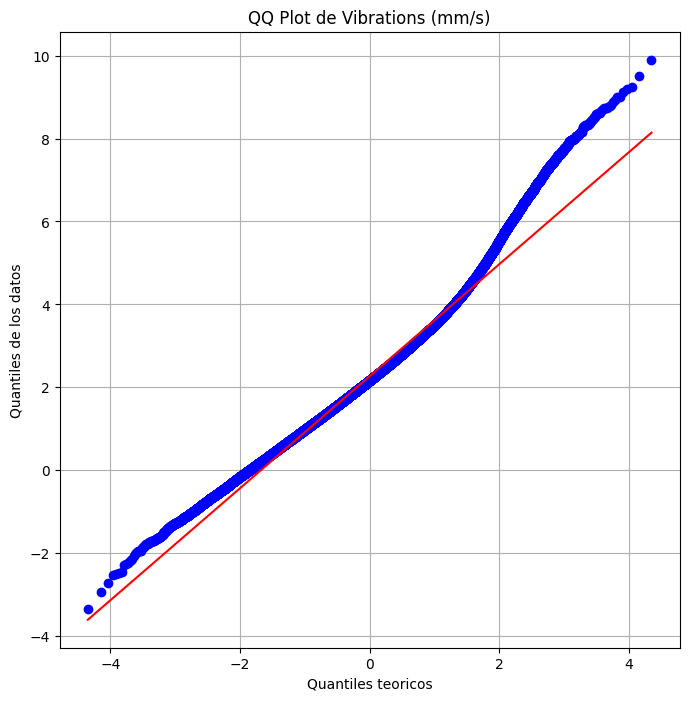

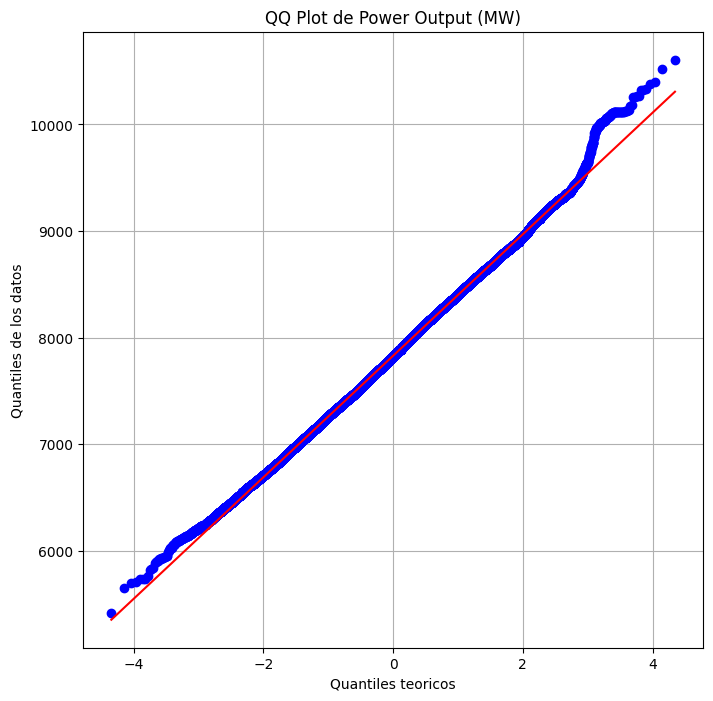

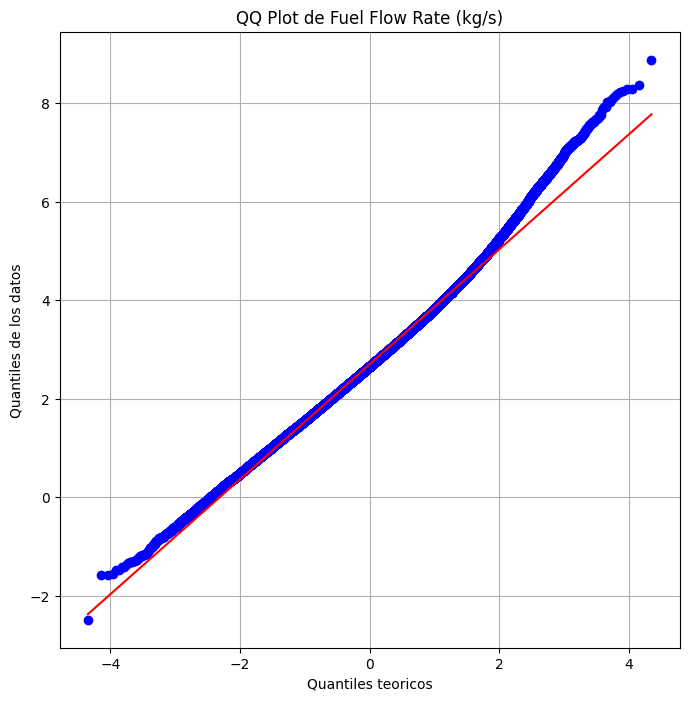

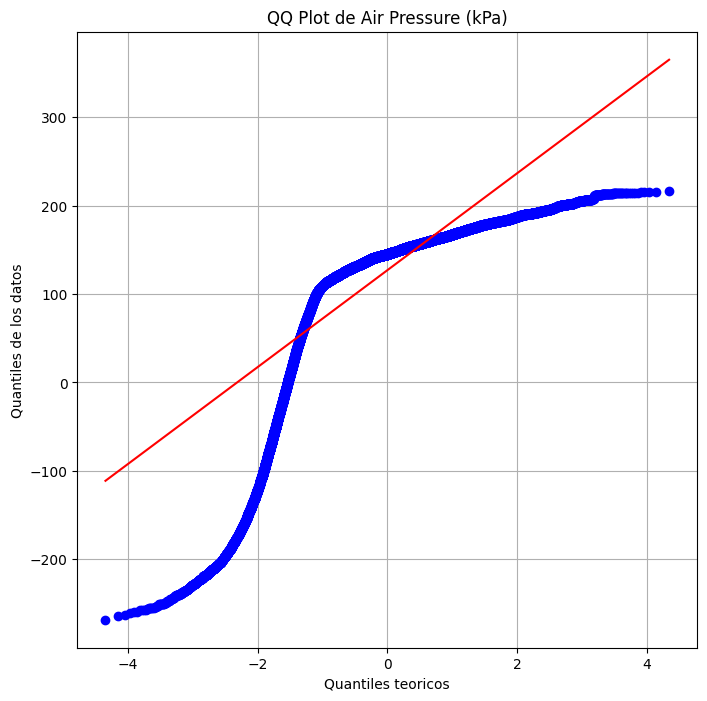

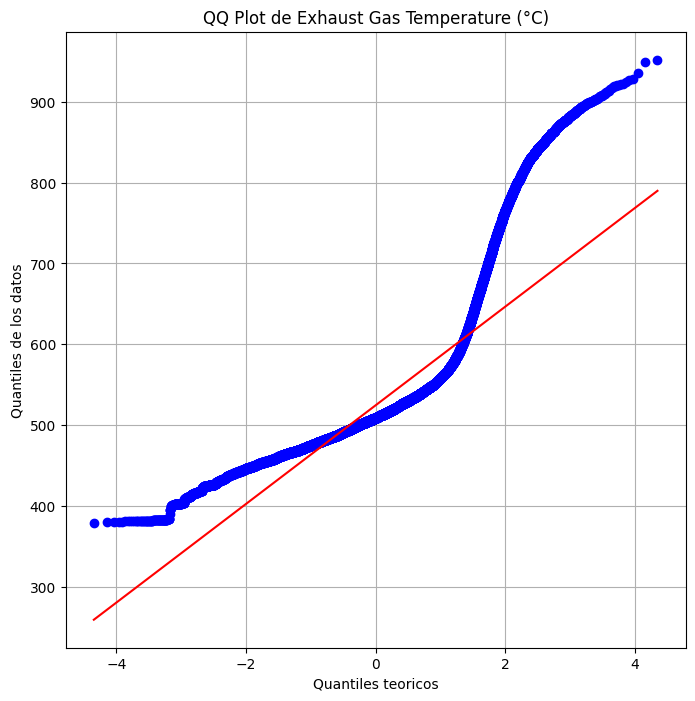

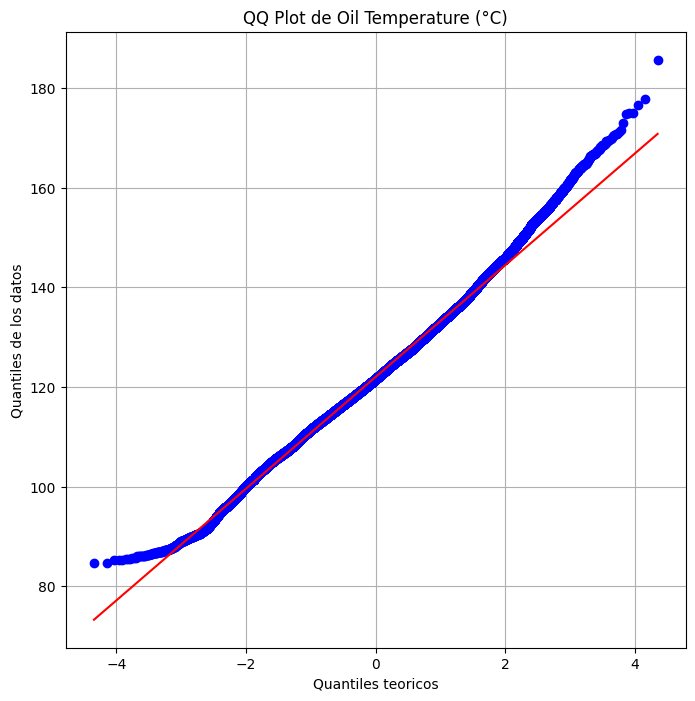

In [21]:
for col in df_sin_pequenos:
    if col == 'Fault' or col == 'Fault Mode' or col == 'TTC' or col == 'Turbine ID':
        break
    plt.figure(figsize=(8,8))
    stats.probplot(df_sin_pequenos[col], dist='norm', plot=plt)
    plt.title(f'QQ Plot de {col}')
    plt.xlabel('Quantiles teoricos')
    plt.ylabel('Quantiles de los datos')
    plt.grid()
    plt.show()

In [23]:
df_sin_pequenos.to_csv('dataset/gas_turbine_fault_detection_simulated3.csv', index=False)

In [7]:
df_sin_pequenos = pd.read_csv('dataset/gas_turbine_fault_detection_simulated3.csv')

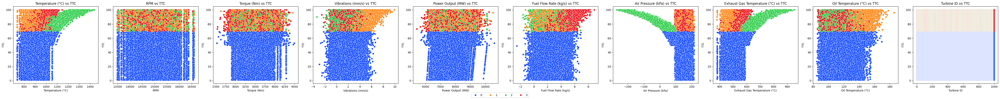

In [8]:
# Si lo que quieres es graficar cada columna (excepto las excluidas) contra TTC
cols_to_plot = [col for col in df_sin_pequenos.columns 
                if col not in ['Fault', 'Fault Mode', 'TurbineID', 'TTC']]

fig, axes = plt.subplots(1, len(cols_to_plot), figsize=(5*len(cols_to_plot), 5))

# Si solo hay una columna, axes no será un array
if len(cols_to_plot) == 1:
    axes = [axes]

for ax, col in zip(axes, cols_to_plot):
    sns.scatterplot(
        data=df_sin_pequenos, 
        x=col, 
        y='TTC', 
        hue='Fault Mode', 
        palette='bright',
        ax=ax
    )
    ax.set_title(f'{col} vs TTC')
    ax.set_xlabel(col)
    ax.set_ylabel('TTC')
    ax.get_legend().remove()

# Añadir leyenda general
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=len(labels))

plt.tight_layout()
plt.subplots_adjust(bottom=0.15)  # Espacio para la leyenda
plt.show()

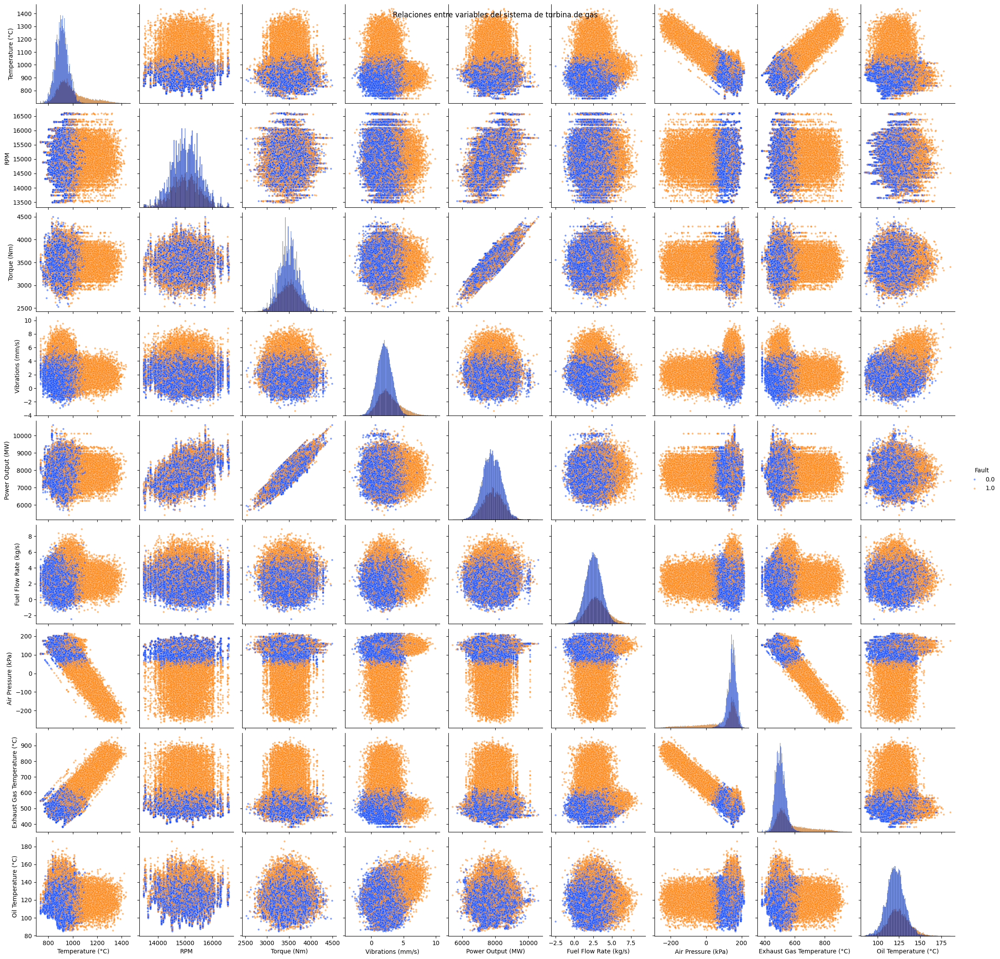

In [3]:
df = pd.read_csv('dataset/gas_turbine_fault_detection_simulated3.csv')

include_cols = [col for col in df.columns 
                if col not in ['Fault Mode', 'Turbine ID', 'TTC']]

sns.pairplot(df[include_cols], diag_kind="hist", hue="Fault", plot_kws={'alpha': 0.5, 's': 10}, palette='bright')
plt.suptitle("Relaciones entre variables del sistema de turbina de gas")
plt.show()

In [6]:
df = pd.read_csv('dataset/gas_turbine_fault_detection_simulated3.csv')

print("Proporciones de Fault:")
print(df['Fault'].value_counts(normalize=True))

print("Proporciones de Fault Mode:")
print(df['Fault Mode'].value_counts(normalize=True))

Proporciones de Fault:
Fault
0.0    0.69
1.0    0.31
Name: proportion, dtype: float64
Proporciones de Fault Mode:
Fault Mode
0    0.69000
3    0.10416
1    0.10292
2    0.10292
Name: proportion, dtype: float64
